<img src='https://neurohive.io/wp-content/uploads/2019/07/Screenshot-from-2019-07-25-01-30-57.png'>
<p>
<p>
<h1><center>Lyft Motion Prediction for Autonomous Vehicles</center><h1>
<h3><center>Build motion prediction models for self-driving vehicles</center><h3>

# <a id='Introduction'>Introduction</a>

This competition is hosted by ridesharing company [Lyft](https://www.lyft.com/) which started [Level 5](https://self-driving.lyft.com/level5/) to tackle the challenges in the field of self-driving cars. 

In this competition our task is to build motion prediction models. Model which can predict the movement of traffic agents around the Autonomous Vehicles such as cars, cyclists, and pedestrians etc. We are required to predict how these different agents move in Autonomous Vehicles's environment. 

## What is Autonomous Vehicle?

An autonomous vehicle, or a driverless vehicle, is one that is able to operate itself and perform necessary functions without any human intervention, through ability to sense its surroundings.

An autonomous vehicle utilises a fully automated driving system in order to allow the vehicle to respond to external conditions that a human driver would manage.

## What we are predicting?

Our task in the competition is to predict the motion of external objects such as cars, cyclist, pedestrains etc in order to assist the self-driving car. We have to predict the location of objects agents in the next 50 frames.

## Evaluation Metric: Negative log-likelihood

We calculate the negative log-likelihood of the ground truth data given the multi-modal predictions. You can get more information [here](https://www.kaggle.com/c/lyft-motion-prediction-autonomous-vehicles/overview/evaluation).


![](https://camo.githubusercontent.com/b3634eea5be5501318957e21086781666018efa1/68747470733a2f2f6c617465782e636f6465636f67732e636f6d2f6769662e6c617465783f25354362675f77686974652532302535436c617267652532304c2532302533442532302d2532302535436c6f6725323070253238785f253742312532432532302535436c646f747325324325323054253744253243253230795f253742312532432532302535436c646f74732532432532305425374425374363253545253742312532432532302535436c646f74732532432532304b253744253243253230253543626172253742782537445f253742312532432532302535436c646f747325324325323054253744253545253742312532432532302535436c646f74732532432532304b253744253243253230253543626172253742792537445f253742312532432532302535436c646f747325324325323054253744253545253742312532432532302535436c646f74732532432532304b253744253239)
![](https://camo.githubusercontent.com/8048a110a20827715a17eb76f8039302a576d503/68747470733a2f2f6c617465782e636f6465636f67732e636f6d2f6769662e6c617465783f25354362675f77686974652532302535436c617267652532302533442532302d2532302535436c6f6725323025354373756d5f6b253230652535452537422535436c6f67253238632535456b2532392532302b25323025354373756d5f742532302535436c6f672532302535436d61746863616c2537424e253744253238785f74253743253543626172253742782537445f742535456b2532432532302535437369676d61253344312532392532302535436d61746863616c2537424e253744253238795f74253743253543626172253742792537445f742535456b2532432532302535437369676d6125334431253239253744)
![](https://camo.githubusercontent.com/9ba94f5c0c40666d66b93fba994cc5f7623ebd98/68747470733a2f2f6c617465782e636f6465636f67732e636f6d2f6769662e6c617465783f25354362675f77686974652532302535436c617267652532302533442532302d2532302535436c6f6725323025354373756d5f6b253230652535452537422535436c6f67253238632535456b2532392532302d25354366726163253742312537442537423225374425323025354373756d5f74253230253238253543626172253742782537445f742535456b2532302d253230785f74253239253545322532302b253230253238253543626172253742792537445f742535456b2532302d253230795f7425323925354532253744)

# Table of contents

- [1. Import Packages](#1)

- [2. Utility Functions](#2)

- [3. Basic EDA](#3)
    - [3.1 Data Format: zarr](#3-1)
    - [3.2 Checking Configuration Fields](#3-2)
    - [3.3 Loading Data](#3-3)
    - [3.4 Raw Data Overview: Sample Zarr File](#3-4)
    - [3.5 DataLoader Classes](#3-5)
    - [3.6 Visualize Autonomous Vehicle](#3-6)  
        - [3.6.1 Visualize Trajectory: Semantic View](#3-6-1)
        - [3.6.2 Visualize Trajectory: Satellite View](#3-6-2)
        - [3.6.3 Visualize Agent](#3-6-3)
        - [3.6.4 Visualize Individual Scene: Semantic](#3-6-4)
        - [3.6.5 Visualize Individual Scene: Satellite](#3-6-5)
        
- [4. Pytorch Baseline](#4)
    - [4.1 Configuration](#4-1)
    - [4.2 Loading Training Data](#4-2)
    - [4.3 Training DataLoader](#4-3)
    - [4.4 Model: resnet50 (Pytorch)](#4-4)
    - [4.5 Compilation](#4-5)
    - [4.6 Training](#4-6)
    
- [5. Prediction and Results](#5)
    - [5.1 Test DataLoader](#5-1)
    - [5.2 Getting Predictions](#5-2)
    - [5.2 Submission](#5-3)
    
- [6. Reference](#6)

# <a name='1'>Import Packages</a>

In [1]:
# import packages
import os
import zarr
import numpy as np 
import pandas as pd 
from tqdm import tqdm
from typing import Dict
from collections import Counter
from prettytable import PrettyTable

#level5 toolkit
from l5kit.data import PERCEPTION_LABELS
from l5kit.dataset import EgoDataset, AgentDataset
from l5kit.data import ChunkedDataset, LocalDataManager

# level5 toolkit 
from l5kit.configs import load_config_data
from l5kit.geometry import transform_points
from l5kit.rasterization import build_rasterizer
from l5kit.visualization import draw_trajectory, TARGET_POINTS_COLOR
from l5kit.evaluation import write_pred_csv, compute_metrics_csv, read_gt_csv, create_chopped_dataset

# visualization
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

# deep learning
import torch
from torch import nn, optim
from torch.utils.data import DataLoader
from torchvision.models.resnet import resnet18, resnet50, resnet34

# directory
os.listdir('../input/lyft-motion-prediction-autonomous-vehicles/')

plt.rc('animation', html='jshtml')

In [2]:
HTML('<center><iframe  width="850" height="450" src="https://www.youtube.com/embed/K0H43N-Hx7w" frameborder="0" allow="accelerometer; autoplay; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe></center>')

# <a name='2'>Utility Functions</a>

Thanks to [Trigram](https://www.kaggle.com/nxrprime) for providing this function.

In [3]:
# animation for scene
def animate_solution(images):

    def animate(i):
        im.set_data(images[i])
 
    fig, ax = plt.subplots()
    im = ax.imshow(images[0])
    
    return animation.FuncAnimation(fig, animate, frames=len(images), interval=80)

# <a name='3'>EDA</a>

The data is huge around 22 GB. We will use Lyft's [L5Kit](https://github.com/lyft/l5kit) to process our data (loading and visualization) and training. 

## <a name='3-1'>Data Format: zarr</a>

The data is available in .zarr file format which can be easily load using the [L5Kit](https://github.com/lyft/l5kit). Most of the traditional numpy operations can be handled using .zarr files. Each of the .zarr file contains - 

   * scenes: driving episodes acquired from a given vehicle.
   * frames: snapshots in time of the pose of the vehicle.
   * agents: a generic entity captured by the vehicle's sensors. Note that only 4 of the 17 possible agent label_probabilities are present in this dataset.
   * agents_mask: a mask that (for train and validation) masks out objects that aren't useful for training. In test, the mask (provided in files as mask.npz) masks out any test object for which predictions are NOT required.
   * traffic_light_faces: traffic light information.

The data is expected to live in a folder that can be configured using the L5KIT_DATA_FOLDER env variable. We will now develop some intuition for the configuration data.

In [4]:
# set env variable for data
os.environ["L5KIT_DATA_FOLDER"] = "../input/lyft-motion-prediction-autonomous-vehicles"

# get config
cfg = load_config_data("../input/lyft-config-files/visualisation_config.yaml")
cfg['val_data_loader']
print(cfg)

{'format_version': 4, 'model_params': {'model_architecture': 'resnet50', 'history_num_frames': 0, 'history_step_size': 1, 'history_delta_time': 0.1, 'future_num_frames': 50, 'future_step_size': 1, 'future_delta_time': 0.1}, 'raster_params': {'raster_size': [224, 224], 'pixel_size': [0.5, 0.5], 'ego_center': [0.25, 0.5], 'map_type': 'py_semantic', 'satellite_map_key': 'aerial_map/aerial_map.png', 'semantic_map_key': 'semantic_map/semantic_map.pb', 'dataset_meta_key': 'meta.json', 'filter_agents_threshold': 0.5}, 'val_data_loader': {'key': 'scenes/sample.zarr', 'batch_size': 12, 'shuffle': False, 'num_workers': 16}}


## <a name='3-2'>Checking Configuration Fields</a>

We can look at curent configuration inside our cgf file for interesting fields. The yaml file is converted to python dictionary. Let's look the **raster_params** filed. It contains information related to the transformation of the 3D world onto image plane. 

In [5]:
# Raster Parameters
print(f'current raster_param:\n')
for k,v in cfg["raster_params"].items():
    print(f"{k}:{v}")

current raster_param:

raster_size:[224, 224]
pixel_size:[0.5, 0.5]
ego_center:[0.25, 0.5]
map_type:py_semantic
satellite_map_key:aerial_map/aerial_map.png
semantic_map_key:semantic_map/semantic_map.pb
dataset_meta_key:meta.json
filter_agents_threshold:0.5


## <a name='3-3'>Loading Data</a>

We are using dataset from the sample set. You can change this by configuring the **'train_data_loader'** variable in the yaml configuration file. This include metadata such as number of scenes, frames and agents along with the total time, the average frames-per-scene, average agents-per-frame, average scene time and frame frequency.

In [6]:
dm = LocalDataManager()
dataset_path = dm.require(cfg["val_data_loader"]["key"])
zarr_dataset = ChunkedDataset(dataset_path)
zarr_dataset.open()
print(zarr_dataset)

+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|    100     |   24838    |  1893736   |       0.69      |        248.38        |        76.24         |        24.83         |        10.00        |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+


### Train Data

We are going to load our train.zarr file.

In [7]:
train = zarr.open("../input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr")
train.info

Name,/
Type,zarr.hierarchy.Group
Read-only,False
Store type,zarr.storage.DirectoryStore
No. members,5
No. arrays,4
No. groups,1
Arrays,"agents, frames, scenes, traffic_light_faces"
Groups,agents_mask


We can see that our train.zarr file has set of 4 arrays. All this 4 fields are described above in the **Data Format** section above. Let us check these fields. We will check 1 observation from each.

In [8]:
train.agents[:1]

array([([  665.03424072, -2207.51220703], [4.3913283, 1.8138304, 1.5909758], 1.0166751, [0., 0.], 1, [0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])],
      dtype=[('centroid', '<f8', (2,)), ('extent', '<f4', (3,)), ('yaw', '<f4'), ('velocity', '<f4', (2,)), ('track_id', '<u8'), ('label_probabilities', '<f4', (17,))])

In [9]:
train.scenes[:1]

array([([  0, 248], 'host-a013', 1572643684617362176, 1572643709617362176)],
      dtype=[('frame_index_interval', '<i8', (2,)), ('host', '<U16'), ('start_time', '<i8'), ('end_time', '<i8')])

In [10]:
train.frames[:1]

array([(1572643684801892606, [ 0, 38], [0, 0], [  680.61975098, -2183.32763672,   288.5411377 ], [[ 0.54673314, -0.83729434,  0.00459086], [ 0.83528739,  0.54502565, -0.07240184], [ 0.05811952,  0.04341917,  0.997365  ]])],
      dtype=[('timestamp', '<i8'), ('agent_index_interval', '<i8', (2,)), ('traffic_light_faces_index_interval', '<i8', (2,)), ('ego_translation', '<f8', (3,)), ('ego_rotation', '<f8', (3, 3))])

In [11]:
train.traffic_light_faces[:1]

array([('xbVG', '/ggb', [0., 0., 1.])],
      dtype=[('face_id', '<U16'), ('traffic_light_id', '<U16'), ('traffic_light_face_status', '<f4', (3,))])

## <a name='3-4'>Raw Data Overview: Sample Zarr File</a>

### <a name='3-4-1'>Agents</a>

We will now develop some intuition for the agent field. As it is already mention in the data section of the competition that only 4 of the 17 possible agent label_probabilities are present in this dataset. **"Agent"** generic entity captured by the vehicle's sensors.

In [12]:
agents = zarr_dataset.agents
probabilities = agents["label_probabilities"]
labels_indexes = np.argmax(probabilities, axis=1)
counts = []
for idx_label, label in enumerate(PERCEPTION_LABELS):
    counts.append(np.sum(labels_indexes == idx_label))
    
table = PrettyTable(field_names=["label", "counts"])
for count, label in zip(counts, PERCEPTION_LABELS):
    table.add_row([label, count])
print(table)

+------------------------------------+---------+
|               label                |  counts |
+------------------------------------+---------+
|      PERCEPTION_LABEL_NOT_SET      |    0    |
|      PERCEPTION_LABEL_UNKNOWN      | 1324481 |
|     PERCEPTION_LABEL_DONTCARE      |    0    |
|        PERCEPTION_LABEL_CAR        |  519385 |
|        PERCEPTION_LABEL_VAN        |    0    |
|       PERCEPTION_LABEL_TRAM        |    0    |
|        PERCEPTION_LABEL_BUS        |    0    |
|       PERCEPTION_LABEL_TRUCK       |    0    |
| PERCEPTION_LABEL_EMERGENCY_VEHICLE |    0    |
|   PERCEPTION_LABEL_OTHER_VEHICLE   |    0    |
|      PERCEPTION_LABEL_BICYCLE      |    0    |
|    PERCEPTION_LABEL_MOTORCYCLE     |    0    |
|      PERCEPTION_LABEL_CYCLIST      |   6688  |
|   PERCEPTION_LABEL_MOTORCYCLIST    |    0    |
|    PERCEPTION_LABEL_PEDESTRIAN     |  43182  |
|      PERCEPTION_LABEL_ANIMAL       |    0    |
|     AVRESEARCH_LABEL_DONTCARE      |    0    |
+-------------------

As we can see indeed there are only four types of agents provided in the dataset such as Cars, Cyclists, Pedestrians and Unknown. We can see that **Unknown** label is more as compared to other three agent labels. 

In [13]:
print(f'Total number of agents in sample .zarr files is {len(zarr_dataset.agents)}. \nAfter summing up the elements in count column we can see we have {(1324481 + 519385 + 6688 + 43182)} agents in total.')

Total number of agents in sample .zarr files is 1893736. 
After summing up the elements in count column we can see we have 1893736 agents in total.


## <a name='3-5'>DataLoader Classes</a>


We will be using below two datasets to generate inputs and targets.

   * EgoDataset: this dataset iterates over the AV annotations
   * AgentDataset: this dataset iterates over other agents annotations

In [14]:
# raster object for visualization
rast = build_rasterizer(cfg, dm)

# EgoDataset object
dataset = EgoDataset(cfg, zarr_dataset, rast)

## <a name='3-6'>Visualize Autonomous Vehicle</a>

We are going to visualize our AV using EgoDataset class.

### <a name='3-6-1'>Visualize Trajectory: Semantic View</a>


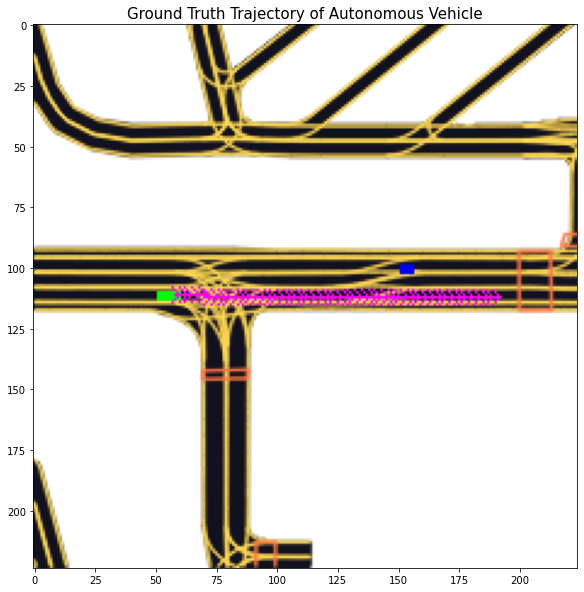

In [15]:
# select one example from our dataset
data = dataset[50]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])

# plot ground truth trajectory
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)

plt.rcParams['figure.figsize'] = 10, 10
plt.title('Ground Truth Trajectory of Autonomous Vehicle',fontsize=15)
plt.imshow(im[::-1])
plt.show()

### <a name='3-6-2'>Visualize Trajectory: Satellite View</a>

We can get the satellite view by changing the parameter **map_type** inside **raster_params** in our configuration file **cfg**.

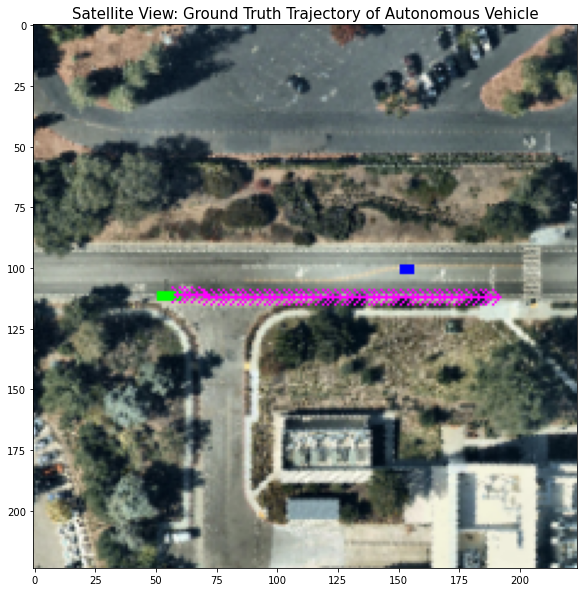

In [16]:
cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)

# EgoDataset object
dataset = EgoDataset(cfg, zarr_dataset, rast)
data = dataset[50]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)

plt.rcParams['figure.figsize'] = 10, 10
plt.title('Satellite View: Ground Truth Trajectory of Autonomous Vehicle',fontsize=15)
plt.imshow(im[::-1])
plt.show()

### <a name='3-6-3'>Visualize Agent</a>

We will visualize our agents using AgentDataset class. 

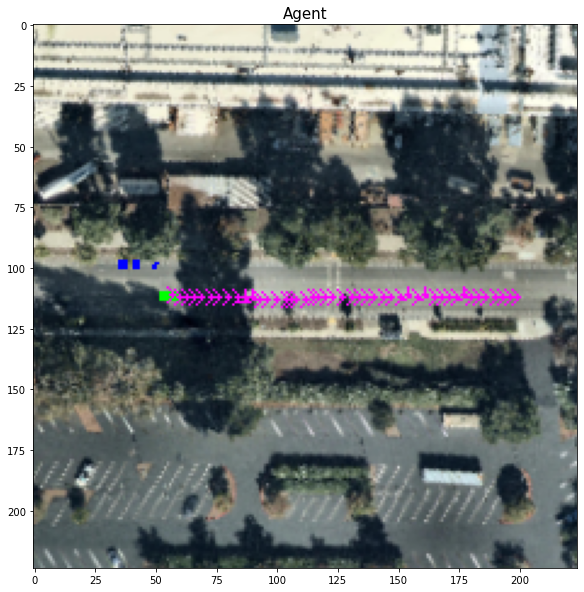

In [17]:
# AgentDataset object
dataset = AgentDataset(cfg, zarr_dataset, rast)
data = dataset[50]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)

plt.rcParams['figure.figsize'] = 10, 10
plt.title('Agent',fontsize=15)
plt.imshow(im[::-1])
plt.show()

The **green** box is our AV agent. The **blue** boxes are entities which we are captured by the sensors. We want to predict the motion of these entities so that our AV can more effectively predict its path. 

### <a name='3-6-4'>Visualize Individual Scene: Semantic</a>


We will visualize the scene in depth.

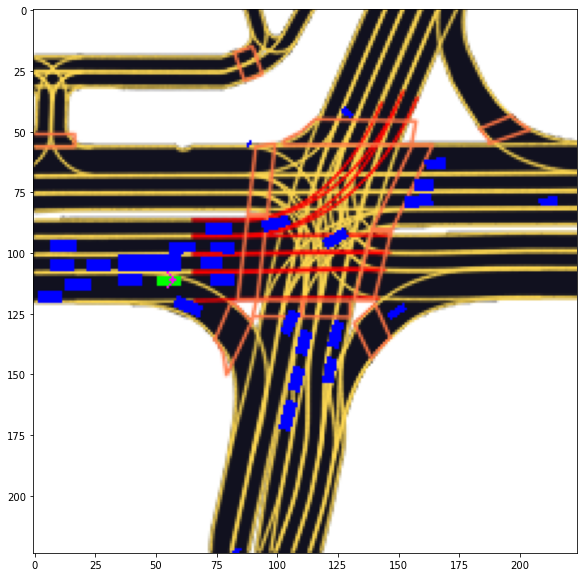

In [18]:
from IPython.display import display, clear_output
import PIL
 
cfg["raster_params"]["map_type"] = "py_semantic"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

for idx in indexes:
    
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))
    
# animation    
anim = animate_solution(images)
HTML(anim.to_jshtml())

* The green box is our AV agent and the arrow on top of it represent its motion. 
* The blue boxes are agents (cars, cyclists, predestrians).
* We can see intersection of roads.
* In animation we can see the AV is moving on straight path.

### <a name='3-6-5'>Visualize Individual Scene: Satellite</a>

We are now going to visualize the satellite view for more detailed understanding.

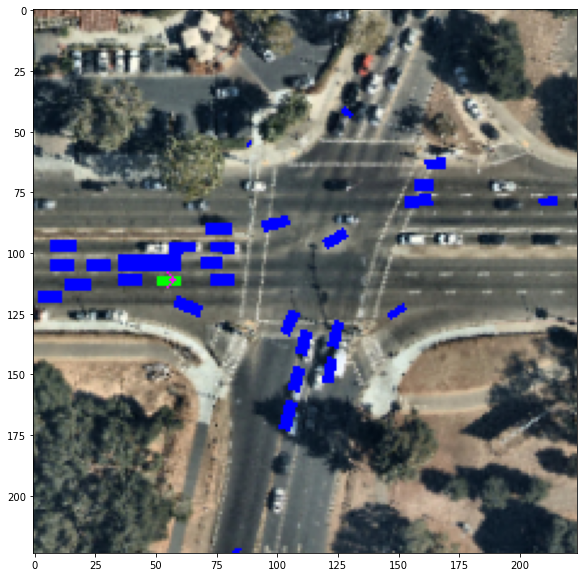

In [19]:
# satellite view
cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

for idx in indexes:
    
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))
    
# animation    
anim = animate_solution(images)
HTML(anim.to_jshtml())

* We can see the green AV agent and blue entities (cars, bicycles and pedestrians).
* We can see our agent in motion in realtion to the movement of other agents (vehicles).

# <a name='4'>Pytorch Baseline</a>

## <a name='4-1'>Configuration</a>

Let us first make our configurations for training and testing then we will load our data.

In [20]:
DEBUG = True

# training cfg
training_cfg = {
    
    'format_version': 4,
    
     ## Model options
    'model_params': {
        'model_architecture': 'resnet34',
        'history_num_frames': 10,
        'history_step_size': 1,
        'history_delta_time': 0.1,
        'future_num_frames': 50,
        'future_step_size': 1,
        'future_delta_time': 0.1,
    },

    ## Input raster parameters
    'raster_params': {
        
        'raster_size': [224, 224], # raster's spatial resolution [meters per pixel]: the size in the real world one pixel corresponds to.
        'pixel_size': [0.5, 0.5], # From 0 to 1 per axis, [0.5,0.5] would show the ego centered in the image.
        'ego_center': [0.25, 0.5],
        'map_type': "py_semantic",
        
        # the keys are relative to the dataset environment variable
        'satellite_map_key': "aerial_map/aerial_map.png",
        'semantic_map_key': "semantic_map/semantic_map.pb",
        'dataset_meta_key': "meta.json",

        # e.g. 0.0 include every obstacle, 0.5 show those obstacles with >0.5 probability of being
        # one of the classes we care about (cars, bikes, peds, etc.), >=1.0 filter all other agents.
        'filter_agents_threshold': 0.5
    },

    ## Data loader options
    'train_data_loader': {
        'key': "scenes/train.zarr",
        'batch_size': 12,
        'shuffle': True,
        'num_workers': 4
    },

    ## Train params
    'train_params': {
        'checkpoint_every_n_steps': 5000,
        'max_num_steps': 100 if DEBUG else 10000
    }
}

# inference cfg
inference_cfg = {
    
    'format_version': 4,
    'model_params': {
        'history_num_frames': 10,
        'history_step_size': 1,
        'history_delta_time': 0.1,
        'future_num_frames': 50,
        'future_step_size': 1,
        'future_delta_time': 0.1
    },
    
    'raster_params': {
        'raster_size': [300, 300],
        'pixel_size': [0.5, 0.5],
        'ego_center': [0.25, 0.5],
        'map_type': 'py_semantic',
        'satellite_map_key': 'aerial_map/aerial_map.png',
        'semantic_map_key': 'semantic_map/semantic_map.pb',
        'dataset_meta_key': 'meta.json',
        'filter_agents_threshold': 0.5
    },
    
        'test_data_loader': {
        'key': 'scenes/test.zarr',
        'batch_size': 8,
        'shuffle': False,
        'num_workers': 4
    }

}

## <a name='4-2'>Loading Training Data</a>


In [21]:
# root directory
DIR_INPUT = "/kaggle/input/lyft-motion-prediction-autonomous-vehicles"

#submission
SINGLE_MODE_SUBMISSION = f"{DIR_INPUT}/single_mode_sample_submission.csv"
MULTI_MODE_SUBMISSION = f"{DIR_INPUT}/multi_mode_sample_submission.csv"

# set env variable for data
os.environ["L5KIT_DATA_FOLDER"] = DIR_INPUT
dm = LocalDataManager(None)
print(training_cfg)

{'format_version': 4, 'model_params': {'model_architecture': 'resnet34', 'history_num_frames': 10, 'history_step_size': 1, 'history_delta_time': 0.1, 'future_num_frames': 50, 'future_step_size': 1, 'future_delta_time': 0.1}, 'raster_params': {'raster_size': [224, 224], 'pixel_size': [0.5, 0.5], 'ego_center': [0.25, 0.5], 'map_type': 'py_semantic', 'satellite_map_key': 'aerial_map/aerial_map.png', 'semantic_map_key': 'semantic_map/semantic_map.pb', 'dataset_meta_key': 'meta.json', 'filter_agents_threshold': 0.5}, 'train_data_loader': {'key': 'scenes/train.zarr', 'batch_size': 12, 'shuffle': True, 'num_workers': 4}, 'train_params': {'checkpoint_every_n_steps': 5000, 'max_num_steps': 100}}


## <a name='4-3'>Training DataLoader</a>


In [22]:
# training cfg
train_cfg = training_cfg["train_data_loader"]

# rasterizer
rasterizer = build_rasterizer(training_cfg, dm)

# dataloader
train_zarr = ChunkedDataset(dm.require(train_cfg["key"])).open()
train_dataset = AgentDataset(training_cfg, train_zarr, rasterizer)
train_dataloader = DataLoader(train_dataset, shuffle=train_cfg["shuffle"], batch_size=train_cfg["batch_size"], 
                             num_workers=train_cfg["num_workers"])
print(train_dataset)

+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   16265    |  4039527   | 320124624  |      112.19     |        248.36        |        79.25         |        24.83         |        10.00        |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+


## <a name='4-4'>Model: resnet50 (Pytorch)</a>


In [23]:
# model class
class LyftL5(nn.Module):
    
    def __init__(self, training_cfg):
        super(LyftL5, self).__init__()
        
        # resnet base model
        self.base = resnet34(pretrained=True, progress=True)
        
        # input channel
        num_history_channels = (training_cfg["model_params"]["history_num_frames"] + 1) * 2
        num_in_channels = 3 + num_history_channels
        
        #Conv2D layer
        self.base.conv1 = nn.Conv2d(
            num_in_channels,
            self.base.conv1.out_channels,
            kernel_size=self.base.conv1.kernel_size,
            stride=self.base.conv1.stride,
            padding=self.base.conv1.padding,
            bias=False,
        )
        
        # change output size to (X, Y) * number of future states
        num_targets = 2 * training_cfg["model_params"]["future_num_frames"]
        
        # output layer
        self.logit = nn.Linear(in_features=512, out_features=num_targets)
        
    # forward pass
    def forward(self, x):
        x = self.base.conv1(x)
        x = self.base.bn1(x)
        x = self.base.relu(x)
        x = self.base.maxpool(x)

        x = self.base.layer1(x)
        x = self.base.layer2(x)
        x = self.base.layer3(x)
        x = self.base.layer4(x)

        x = self.base.avgpool(x)
        x = torch.flatten(x, 1)

        x = self.logit(x)

        return x

## <a name='4-5'>Compilation</a>


In [24]:
# compiling model
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = LyftL5(training_cfg).to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.MSELoss(reduction="none")

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/checkpoints/resnet34-333f7ec4.pth


In [25]:
# get hardware type (CPU, GPU, TPU)
device

device(type='cuda', index=0)

## <a name='4-6'>Training</a>


In [26]:
# training loop
tr_it = iter(train_dataloader)
progress_bar = tqdm(range(training_cfg["train_params"]["max_num_steps"]))

losses_train = []

for _ in progress_bar:
    try:
        data = next(tr_it)
    except StopIteration:
        tr_it = iter(train_dataloader)
        data = next(tr_it)
    model.train()
    torch.set_grad_enabled(True)
    
    # forward pass
    inputs = data["image"].to(device)
    target_availabilities = data["target_availabilities"].unsqueeze(-1).to(device)
    targets = data["target_positions"].to(device)
    
    outputs = model(inputs).reshape(targets.shape)
    loss = criterion(outputs, targets)

    # not all the output steps are valid, but we can filter them out from the loss using availabilities
    loss = loss * target_availabilities
    loss = loss.mean()
    # Backward pass
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    losses_train.append(loss.item())
    progress_bar.set_description(f"loss: {loss.item()} loss(avg): {np.mean(losses_train)}")

loss: 202.49795532226562 loss(avg): 121.56953196287155: 100%|██████████| 100/100 [01:44<00:00,  1.04s/it]


## <a name='4-7'>Saving Model</a>


In [27]:
torch.save(model.state_dict(), f'model_state_last.pth')

# <a name='5'>Prediction and Results</a>

## <a name='5-1'>Test DataLoader</a>

In [28]:
# test configuration
test_cfg = inference_cfg["test_data_loader"]

# Rasterizer
rasterizer = build_rasterizer(inference_cfg, dm)

# Test dataset/dataloader
test_zarr = ChunkedDataset(dm.require(test_cfg["key"])).open()
test_mask = np.load(f"{DIR_INPUT}/scenes/mask.npz")["arr_0"]
test_dataset = AgentDataset(inference_cfg, test_zarr, rasterizer, agents_mask=test_mask)
test_dataloader = DataLoader(test_dataset,
                             shuffle=test_cfg["shuffle"],
                             batch_size=test_cfg["batch_size"],
                             num_workers=test_cfg["num_workers"])


print(test_dataloader)

warning, you're running with a custom agents_mask


## <a name='5-2'>Getting Predictions</a>

In [29]:
model.eval()
torch.set_grad_enabled(False)

# store information for evaluation
future_coords_offsets_pd = []
timestamps = []

agent_ids = []
progress_bar = tqdm(test_dataloader)
for data in progress_bar:
    
    inputs = data["image"].to(device)
    target_availabilities = data["target_availabilities"].unsqueeze(-1).to(device)
    targets = data["target_positions"].to(device)

    outputs = model(inputs).reshape(targets.shape)
    
    future_coords_offsets_pd.append(outputs.cpu().numpy().copy())
    timestamps.append(data["timestamp"].numpy().copy())
    agent_ids.append(data["track_id"].numpy().copy())

100%|██████████| 8891/8891 [1:52:35<00:00,  1.32it/s]  


## <a name='5-3'>Submission</a>

In [30]:
# submission.csv
write_pred_csv('submission.csv',
               timestamps=np.concatenate(timestamps),
               track_ids=np.concatenate(agent_ids),
               coords=np.concatenate(future_coords_offsets_pd),
              )

# <a name='6'>References</a>


* https://www.twi-global.com/technical-knowledge/faqs/what-is-an-autonomous-vehicle
* [Negative log-likelihood](https://github.com/lyft/l5kit/blob/master/competition.md)
* https://www.kaggle.com/pestipeti/pytorch-baseline-train

# CONTINUE...